# Classifiers, Object Detection

# Libraries used and their versions

The following libraries and their versions were installed and are required to run this program. Note that a lot of requirements were installed as part of Part 2 (YoloV5).
```
appnope            0.1.4
asttokens          2.4.1
certifi            2024.8.30
charset-normalizer 3.4.0
comm               0.2.2
contourpy          1.3.0
cycler             0.12.1
debugpy            1.8.7
decorator          5.1.1
executing          2.1.0
filelock           3.16.1
fonttools          4.54.1
fsspec             2024.10.0
gitdb              4.0.11
GitPython          3.1.43
idna               3.10
ipykernel          6.29.5
ipython            8.28.0
jedi               0.19.1
Jinja2             3.1.4
joblib             1.4.2
jupyter_client     8.6.3
jupyter_core       5.7.2
kiwisolver         1.4.7
MarkupSafe         3.0.2
matplotlib         3.9.2
matplotlib-inline  0.1.7
mpmath             1.3.0
nest-asyncio       1.6.0
networkx           3.4.2
numpy              1.26.4
opencv-python      4.10.0.84
packaging          24.1
pandas             2.2.3
parso              0.8.4
pexpect            4.9.0
pillow             11.0.0
pip                24.2
platformdirs       4.3.6
prompt_toolkit     3.0.48
psutil             6.1.0
ptyprocess         0.7.0
pure_eval          0.2.3
py-cpuinfo         9.0.0
Pygments           2.18.0
pyparsing          3.2.0
python-dateutil    2.9.0.post0
pytz               2024.2
PyYAML             6.0.2
pyzmq              26.2.0
requests           2.32.3
scikit-learn       1.5.2
scipy              1.14.1
seaborn            0.13.2
setuptools         75.3.0
six                1.16.0
smmap              5.0.1
stack-data         0.6.3
sympy              1.13.1
thop               0.1.1-2209072238
threadpoolctl      3.5.0
torch              2.5.1
torchvision        0.20.1
tqdm               4.66.6
traitlets          5.14.3
typing_extensions  4.12.2
tzdata             2024.2
ultralytics        8.3.27
ultralytics-thop   2.0.10
urllib3            2.2.3
wcwidth            0.2.13
```

# Imports

In [1]:
import pandas as pd
import numpy as np
import random
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
import seaborn as sns
from sklearn.ensemble import RandomForestClassifier
import cv2 
import torch

# Path and Seed

In [2]:
path = "./"
seed = 42

# Set the random seed
np.random.seed(seed)
random.seed(seed)
torch.manual_seed(seed)

# Q1 MNIST Classification

## 1.1 Data Preparation

In [3]:
# We first load the training and testing CSV files into Pandas dataframes.
train = pd.read_csv(path + "data/train.csv")
test = pd.read_csv(path + "data/test.csv")

print("Size of the training set: ", train.shape)
print("Size of the testing set: ", test.shape)

Size of the training set:  (19999, 785)
Size of the testing set:  (9999, 785)


In [10]:
# We then divide the training data into training and validation sets with an 80% to 20% ratio (we use sklearn.model_selection.train_test_split as suggested.

train, val = train_test_split(train, test_size=0.2, shuffle=True, random_state=seed)

# Split the training data into features and target
# Imported rows contains pixel values in columns 0 to 784, with the last column indicating the label
X_train = train.iloc[:, :-1]
y_train = train.iloc[:, -1]

X_val = np.array(val.iloc[:, :-1])
y_val = val.iloc[:, -1]

X_test = test.iloc[:, :-1]
y_test = test.iloc[:, -1]

# Cast the data to numpy arrays
X_train = np.array(X_train)
y_train = np.array(y_train)

X_val = np.array(X_val)
y_val = np.array(y_val)

X_test = np.array(X_test)
y_test = np.array(y_test)

print("Size of X_train: ", X_train.shape)
print("Size of y_train: ", y_train.shape)

print("Size of X_val: ", X_val.shape)
print("Size of y_val: ", y_val.shape)

print("Size of X_test: ", X_test.shape)
print("Size of y_test: ", y_test.shape)

print("Training example:")
print(X_train[0])
print(y_train[0])

Size of X_train:  (15999, 784)
Size of y_train:  (15999,)
Size of X_val:  (4000, 784)
Size of y_val:  (4000,)
Size of X_test:  (9999, 784)
Size of y_test:  (9999,)
Training example:
[  0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0  54 134 188 236 236 175 123  45   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0 101

In [86]:
# We write a function to plot the image in a given row of the dataset.
def plot_image(example, label, predicted=None):
    pixels = example.reshape((28, 28))

    # We plot the image.
    plt.title(f'Label is {label}. Predicted is {predicted}.' if predicted is not None else f'Label is {label}.')
    plt.imshow(pixels, cmap='gray')    
    plt.axis('off')    
    plt.show()

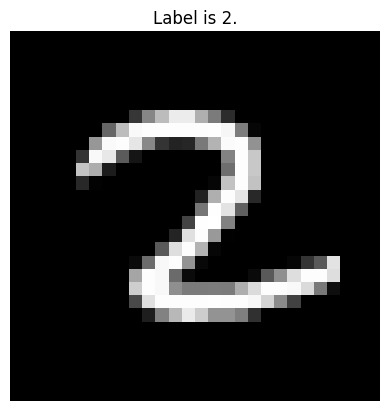

In [87]:
# Plot random images from the training set
plot_image(X_train[0], y_train[0])

## 1.2 Support Vector Machines (SVM)

### Linear SVM

In [88]:
# We now train a linear SVM using the SVC function from Scikit-learn, with the kernel set to 'linear'
# We keep all hyperparameters at their default values. 

# We train the model on the training set
linear_model = SVC(kernel='linear')
linear_model.fit(X_train, y_train)

# We then evaluate the model on the test set
y_linear_pred = linear_model.predict(X_test)
linear_test_accuracy = accuracy_score(y_test, y_linear_pred)
print("Test accuracy: ", linear_test_accuracy)

Test accuracy:  0.9134913491349135


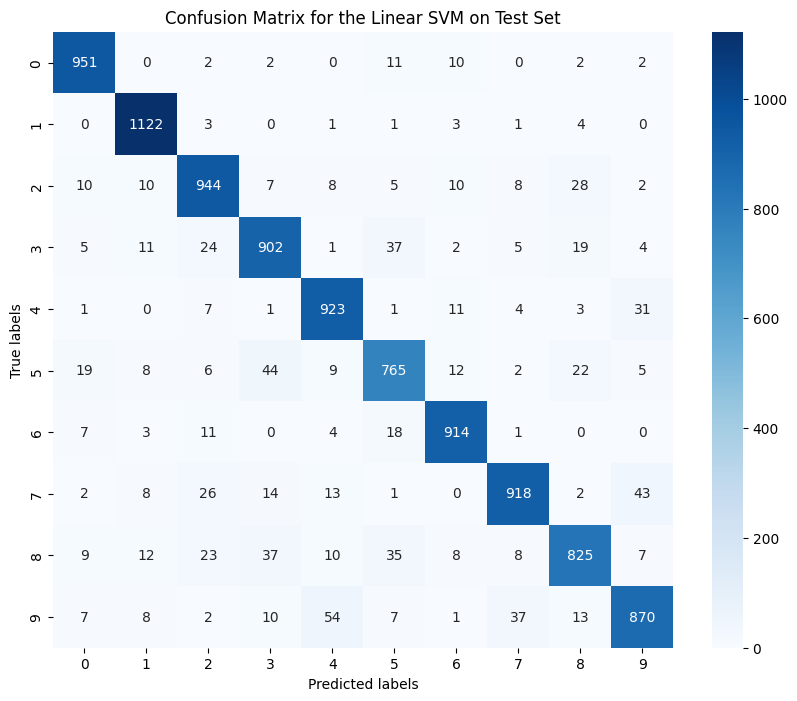

In [89]:
# We now report the confusion matrix of the linear SVM
linear_conf_matrix = confusion_matrix(y_test, y_linear_pred)

plt.figure(figsize=(10, 8))
sns.heatmap(linear_conf_matrix, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted labels')
plt.ylabel('True labels')
plt.title('Confusion Matrix for the Linear SVM on Test Set')
plt.show()

Our Linear SVM achieved an impressive accuracy of approximately 91.3%. Analyzing the confusion matrix reveals that the model excels at predicting ones (1) but struggles more with fives (5) and eights (8). Specifically, it often misclassifies fives as threes and confuses eights with both fives and twos.

### Non-Linear SVMs

In [90]:
# We now train two different SVM classifiers using two distinct kernels: Polynomial and Radial Basis Function (RBF).
# We will use the SVC function from Scikit-learn as well, starting with the RBF kernel.
RBF_model = SVC(kernel='rbf')
RBF_model.fit(X_train, y_train)

# We then evaluate the model on the test set
y_RBF_pred = RBF_model.predict(X_test)
RBF_accuracy = accuracy_score(y_test, y_RBF_pred)
print("Test accuracy: ", RBF_accuracy)

Test accuracy:  0.9684968496849685


In [91]:
# We also implement a grid search to optimize hyperparameters for the polynomial kernel (degree of the polynomial)
degrees = [2, 3, 4, 5, 6]
best_accuracy = 0
best_degree = 0
poly_best_model = None
models_poly = []

# For each degree, we train a polynomial SVM and evaluate it on the validation set, keeping track of the best model and its accuracy.
for degree in degrees:
    model_poly = SVC(kernel='poly', degree=degree)
    model_poly.fit(X_train, y_train)
    
    # We then evaluate the model on the test set
    y_val_poly_pred = model_poly.predict(X_val)
    accuracy = accuracy_score(y_val, y_val_poly_pred)
    print(f"Validation accuracy for degree {degree}:", accuracy)

    if accuracy > best_accuracy:
        best_accuracy = accuracy
        best_degree = degree
        poly_best_model = model_poly
    models_poly.append(model_poly)

# We then report the best parameters along with the accuracy and confusion matrix.
print("___________________________")
print("Best degree: ", best_degree)
print("Best accuracy: ", best_accuracy)

Validation accuracy for degree 2: 0.96975
Validation accuracy for degree 3: 0.96775
Validation accuracy for degree 4: 0.95375
Validation accuracy for degree 5: 0.93225
Validation accuracy for degree 6: 0.89575
___________________________
Best degree:  2
Best accuracy:  0.96975


We notice that the best degree for the polynomial kernel is 2, with higher degrees leading to poorer performance. This is likely due to overfitting.

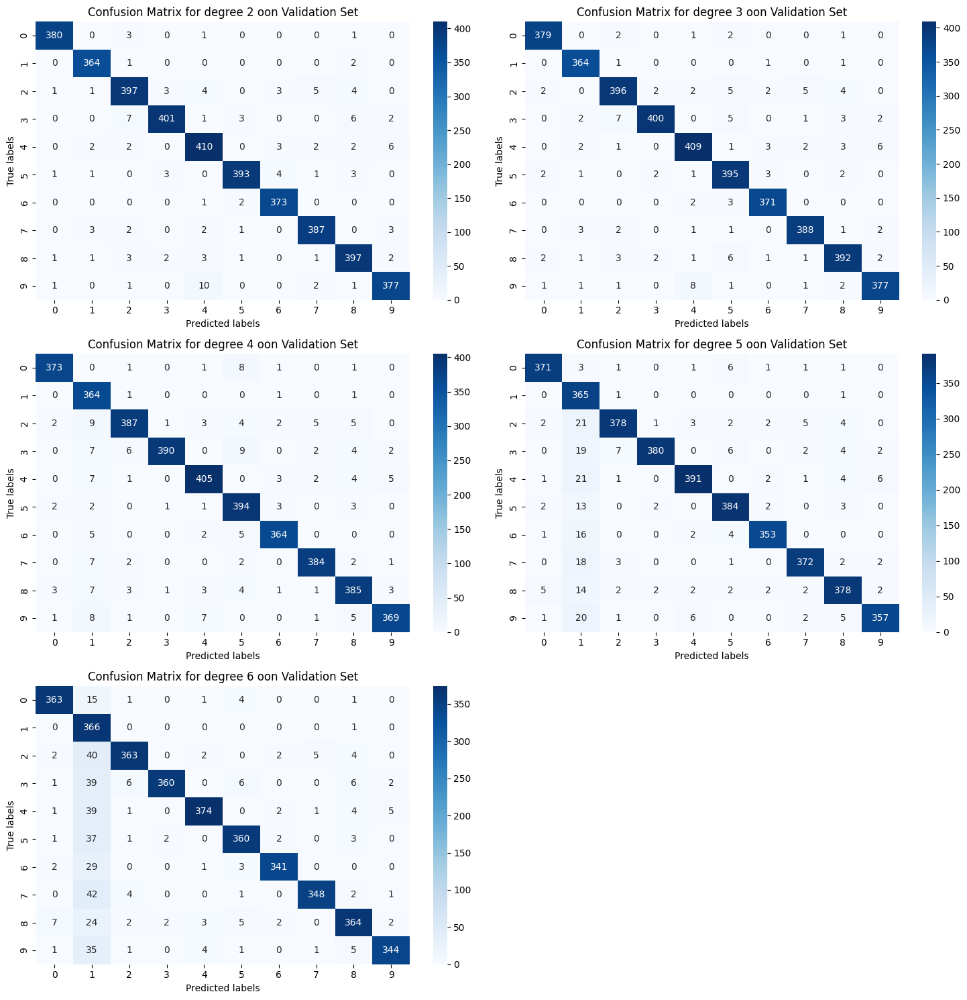

In [92]:
# We now plot the confusion matrix for all models tyrained wiht polynomial kernel
# We still use the validation set to evaluate the models
plt.figure(figsize=(15, 15))
for i, model_poly in enumerate(models_poly):
    y_val_poly_pred = model_poly.predict(X_val)
    conf_matrix = confusion_matrix(y_val, y_val_poly_pred)

    plt.subplot(3, 2, i+1)
    plt.title(f"Confusion Matrix for degree {degrees[i]} on Validation Set")
    sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')
    plt.xlabel('Predicted labels')
    plt.ylabel('True labels')

plt.tight_layout()
plt.show()

We also notice that as we increase the value of the degree parameter, the predictions of the model are less accurate. Indeed, if we look at the confusion matrix with a degree of 6, we notice a lot of misclassifications, specifically the model confuses almost all numbers with the number 1, which is a case rarely observed when using a degree of 2 or 3. 

Accuracy of model with linear kernel:  0.9134913491349135
Accuracy of model with RBF kernel:  0.9684968496849685
Accuracy of model with best polynomial kernel:  0.9657965796579658


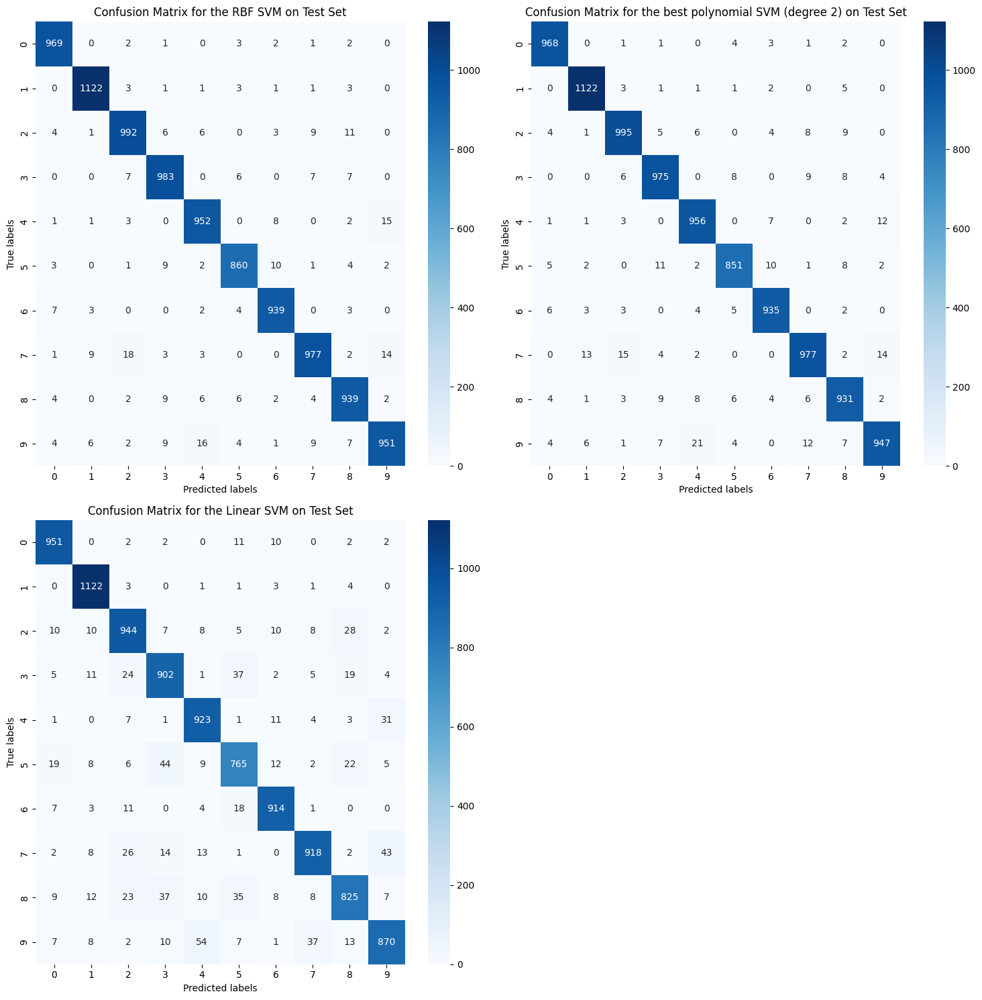

In [93]:
acc_linear = accuracy_score(y_test, linear_model.predict(X_test))
acc_RBF = accuracy_score(y_test, RBF_model.predict(X_test))
acc_poly = accuracy_score(y_test, poly_best_model.predict(X_test))

# We report the accuracy and confusion matrix for both non-linear SVMs on the test set.
print("Accuracy of model with linear kernel: ", acc_linear)
print("Accuracy of model with RBF kernel: ", acc_RBF)
print("Accuracy of model with best polynomial kernel: ", acc_poly)

best_svm_model = linear_model if acc_linear > acc_RBF and acc_linear > acc_poly else RBF_model if acc_RBF > acc_poly else poly_best_model

plt.figure(figsize=(15, 15))
plt.subplot(2, 2, 1)
sns.heatmap(confusion_matrix(y_test, RBF_model.predict(X_test)), annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix for the RBF SVM on Test Set')
plt.xlabel('Predicted labels')
plt.ylabel('True labels')

plt.subplot(2, 2, 2)
sns.heatmap(confusion_matrix(y_test, poly_best_model.predict(X_test)), annot=True, fmt='d', cmap='Blues')
plt.title(f'Confusion Matrix for the best polynomial SVM (degree {best_degree}) on Test Set')
plt.xlabel('Predicted labels')
plt.ylabel('True labels')

plt.subplot(2, 2, 3)
sns.heatmap(confusion_matrix(y_test, linear_model.predict(X_test)), annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix for the Linear SVM on Test Set')
plt.xlabel('Predicted labels')
plt.ylabel('True labels')

plt.tight_layout()
plt.show()

* Which SVM variant yields better results? 

Among the tested SVM variants, the model utilizing the RBF kernel demonstrated superior performance, achieving an accuracy of approximately 96.8%. This is slightly higher than the 96.6% accuracy of the model with the 2-polynomial kernel and significantly better than the 91.3% accuracy of the linear SVM model. The enhanced performance of the RBF kernel SVM is also shown in its confusion matrix, which shows fewer misclassifications across nearly all digits compared to the other models. Both the RBF and 2-polynomial kernel models notably outperform the linear model in digit recognition accuracy. For instance, in classifying the digit 5, the RBF model correctly identified it 860 times, the polynomial model 851 times, and the linear model only 765 times.

* Is this outcome expected?

Yes, the outcome is expected. The RBF kernel is well-regarded for its ability to handle non-linear data by mapping inputs into higher-dimensional spaces where classes are more easily separable. This characteristic often leads to higher accuracy in complex classification tasks such as this one. On the other hand, the linear SVM model is typically less effective for such tasks due to its limitations in dealing only with linear separability but is still a good option for simpler classification tasks. The linear kernel function is a good choice when the data is linearly separable which is not the case in this scenario.

## 1.3 Random Forest Classifiers

In [94]:
# We now train a Random Forest classifier using Scikit-learn with the following parameters: n_estimators=100 , criterion='entropy' and retain all other parameters at their defaults as instructed.
random_forest = RandomForestClassifier(n_estimators=100, criterion='entropy')

# We train the model on the training set
random_forest.fit(X_train, y_train)

# We now report the classifier's performance.
y_rf_pred = random_forest.predict(X_test)
rf_accuracy = accuracy_score(y_test, y_rf_pred)
print("Test accuracy: ", rf_accuracy)

Test accuracy:  0.9585958595859586


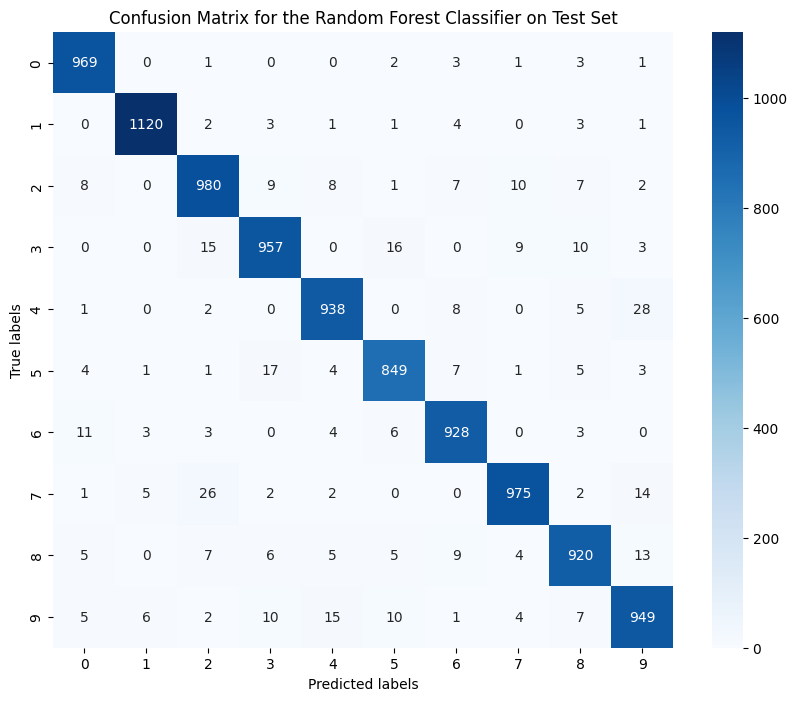

In [95]:
# We plot the confusion matrix for the Random Forest classifier we just trained
plt.figure(figsize=(10, 8))
sns.heatmap(confusion_matrix(y_test, y_rf_pred), annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted labels')
plt.ylabel('True labels')
plt.title('Confusion Matrix for the Random Forest Classifier on Test Set')
plt.show()

The Random Forest Classifier achieved an accuracy of approximately 95.9%, which is comparable to polynomial kernel SVM models we trained before. The confusion matrix shows that the model is very good at predicting the number 1 but has the most difficulties with identifying the number 5, often confusing it with the number 3.

In [96]:
# We now train various Random Forest classifiers with different numbers of trees 
# We conduct three experiments using n_estimators values of 50, 150, and 250. 
# We also evaluate the impact of max depth on the performance.

n_estimators = [50, 150, 250]
max_depths = [10, 30, 50]

best_accuracy = 0
best_depth = 0
best_n_estimators = 0
best_rf_model = None
models_rf = {}

# For each number of trees, we train a Random Forest classifier and evaluate it on the validation set, keeping track of the best model and its accuracy.
for n in n_estimators:
    for depth in max_depths:
        # Keep the criterion as 'entropy'
        model_rf = RandomForestClassifier(n_estimators=n, criterion='entropy', max_depth=depth)
        model_rf.fit(X_train, y_train)
        
        # We then evaluate the model on the validation set
        y_val_rf_pred = model_rf.predict(X_val)
        accuracy = accuracy_score(y_val, y_val_rf_pred)
        print(f"Validation accuracy for n_estimators {n} and max_depth {depth}:", accuracy)

        if accuracy > best_accuracy:
            best_accuracy = accuracy
            best_n_estimators = n
            best_depth = depth
            best_rf_model = model_rf
        models_rf[(n, depth)] = model_rf

# We then report the best parameters along with the accuracy
print("_______________________")
print("Best number of trees: ", best_n_estimators)
print("Best max depth: ", best_depth)
print("Best accuracy: ", best_accuracy)

Validation accuracy for n_estimators 50 and max_depth 10: 0.95075
Validation accuracy for n_estimators 50 and max_depth 30: 0.95975
Validation accuracy for n_estimators 50 and max_depth 50: 0.95675
Validation accuracy for n_estimators 150 and max_depth 10: 0.95275
Validation accuracy for n_estimators 150 and max_depth 30: 0.96175
Validation accuracy for n_estimators 150 and max_depth 50: 0.96175
Validation accuracy for n_estimators 250 and max_depth 10: 0.95375
Validation accuracy for n_estimators 250 and max_depth 30: 0.9635
Validation accuracy for n_estimators 250 and max_depth 50: 0.9625
_______________________
Best number of trees:  250
Best max depth:  30
Best accuracy:  0.9635


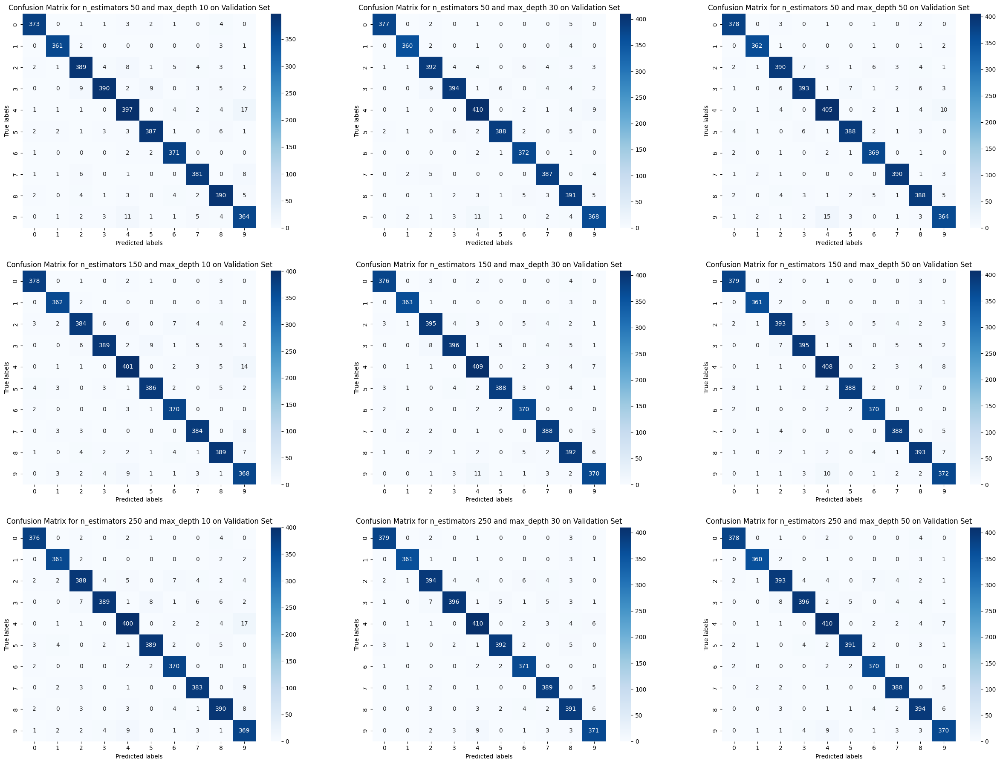

In [99]:
# We plot the confusion matrix for all models trained with different numbers of trees and different depths
# We still use the validation set to evaluate the models
plt.figure(figsize=(30, 30))
for i, (n, depth) in enumerate(models_rf):
    model_rf = models_rf[(n, depth)]
    y_val_rf_pred = model_rf.predict(X_val)
    conf_matrix = confusion_matrix(y_val, y_val_rf_pred)

    plt.subplot(4, 3, i+1)
    plt.title(f"Confusion Matrix for n_estimators {n} and max_depth {depth} on Validation Set")
    sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')
    plt.xlabel('Predicted labels')
    plt.ylabel('True labels')

| Max Depth | Number of Trees = 50 | Number of Trees = 150 | Number of Trees = 200 |
| --- | --- | --- | --- |
| 10 | 95.0% | 95.3% | 95.4% |
| 30 | 96.0% | 96.2% | 96.4% |
| 50 | 95.7% | 96.2% | 96.3% |

This table shows the accuracy of the Random Forest Classifier with different hyperparameters. We can see that the best accuracy of 96.4% is achieved with a max depth of 30 and 200 trees.

Comparing the results we notice that for any fixed maximum depth value we use, the higher the `n_estimator` hyperparameter is, the best accuracy we obtain. Indeed, in our table, all accuracies in the column corresponding to 200 trees are higher than the ones in the column corresponding to 150 trees, which in turn are higher than the ones in the column corresponding to 50 trees. Thus we so notice an improvement in classification performance as we increase the number of trees in the Random Forest Classifier. This is expected as Random Forests are ensemble methods that combine multiple decision trees to improve the accuracy of the model. The more trees we have, the more robust the model is to overfitting and the more accurate the predictions are. The best number of trees is therefore 200.

Regarding maximum depth, we notice that for a small number of trees used (50) we get the haighest accuracy when using a maximum depth of 50. However, as we increase the number of trees, the best accuracy is achieved with a maximum depth of 30. This is likely due to the fact that the model is more robust to overfitting when we have more trees, so we can afford to have a smaller maximum depth. 

In our case, the best accuracy is achieved with a maximum depth of 30 and 200 trees.

## 1.4 Comparison of Classifiers

### 1.4.1 Performance Analysis

Training accuracy of the best Random Forest model:  1.0
Training accuracy of the best SVM model:  0.9866241640102507


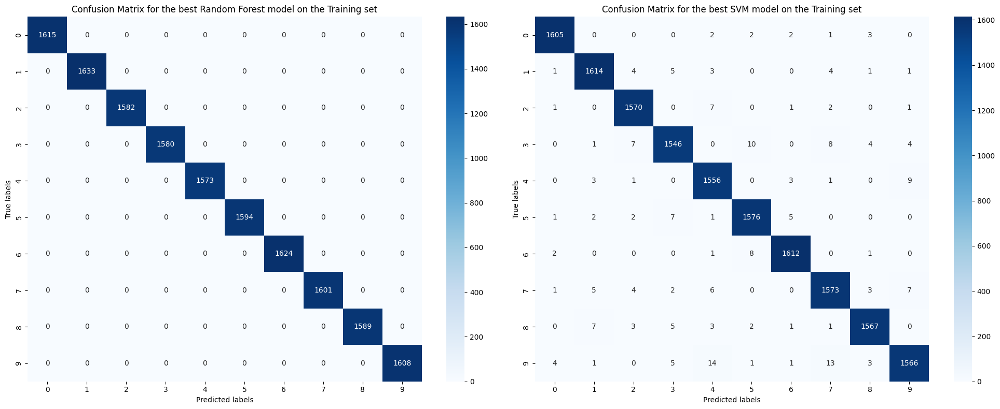

In [101]:
# We compare the best-performing Random Forest classifier (number of trees) with the best-performing SVM classifier (kernel type) 
# Based on accuracy and confusion matrices for both training and validation sets. 

# TRAINING SET
# We compute the accuracy of the best Random Forest and SVM models on the training set
rf_train_accuracy = accuracy_score(y_train, best_rf_model.predict(X_train))
svm_train_accuracy = accuracy_score(y_train, best_svm_model.predict(X_train))
print("Training accuracy of the best Random Forest model: ", rf_train_accuracy)
print("Training accuracy of the best SVM model: ", svm_train_accuracy)

# We plot the confusion matrix for the best Random Forest model and the best SVM model
plt.figure(figsize=(20, 8))

plt.subplot(1, 2, 1)
sns.heatmap(confusion_matrix(y_train, best_rf_model.predict(X_train)), annot=True, fmt='d', cmap='Blues')
plt.title(f'Confusion Matrix for the best Random Forest model on the Training set')
plt.xlabel('Predicted labels')
plt.ylabel('True labels')

plt.subplot(1, 2, 2)
sns.heatmap(confusion_matrix(y_train, best_svm_model.predict(X_train)), annot=True, fmt='d', cmap='Blues')
plt.title(f'Confusion Matrix for the best SVM model on the Training set')
plt.xlabel('Predicted labels')
plt.ylabel('True labels')

plt.tight_layout()
plt.show()

Comparing our best-performing Random Forest Classifier (`n_estimators=200`, `max_depth=30`) with our best-performing SVM model (RBF kernel), we notice that the Random Forest Classifier has a higher training accuracy of 100% compared to the SVM's 98.6%. The Random Forest Classifier makes no mistakes on the training set, as opposed to the SVM model that has a few misclassifications specifically when predicting the number 9.

Validation accuracy of the best Random Forest model:  0.9635
Validation accuracy of the best SVM model:  0.97175


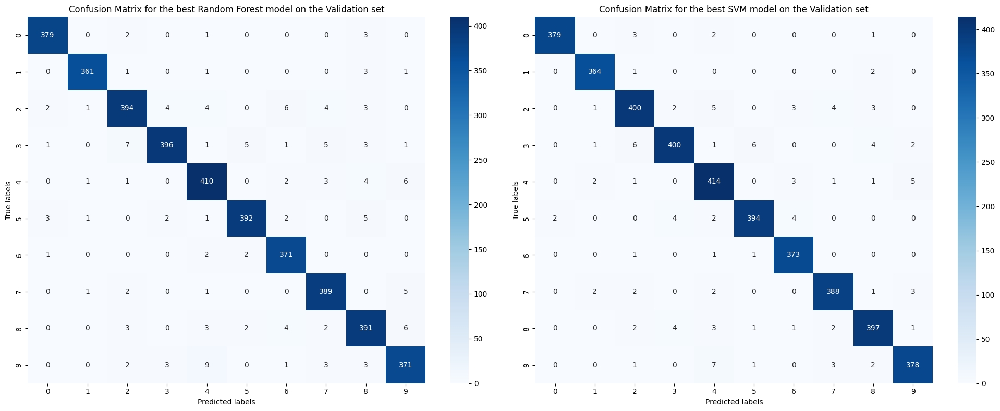

In [102]:
# VALIDATION SET
# We compute the accuracy of the best Random Forest and SVM models on the validation set
rf_val_accuracy = accuracy_score(y_val, best_rf_model.predict(X_val))
svm_val_accuracy = accuracy_score(y_val, best_svm_model.predict(X_val))
print("Validation accuracy of the best Random Forest model: ", rf_val_accuracy)
print("Validation accuracy of the best SVM model: ", svm_val_accuracy)

# We plot the confusion matrix for the best Random Forest model and the best SVM model
plt.figure(figsize=(20, 8))

plt.subplot(1, 2, 1)
sns.heatmap(confusion_matrix(y_val, best_rf_model.predict(X_val)), annot=True, fmt='d', cmap='Blues')
plt.title(f'Confusion Matrix for the best Random Forest model on the Validation set')
plt.xlabel('Predicted labels')
plt.ylabel('True labels')

plt.subplot(1, 2, 2)
sns.heatmap(confusion_matrix(y_val, best_svm_model.predict(X_val)), annot=True, fmt='d', cmap='Blues')
plt.title(f'Confusion Matrix for the best SVM model on the Validation set')
plt.xlabel('Predicted labels')
plt.ylabel('True labels')

plt.tight_layout()
plt.show()

We notice that although the Random Forest Classifier had a higher training accuracy, the SVM model has a higher validation accuracy of 97.2% compared to the Random Forest Classifier's 96.4%. This is likely due to the fact that the Random Forest Classifier is more prone to overfitting than the SVM model (a training accuracy of 100% is also a strong sign of overfitting). Analyzing the confusion matrices, we notice the SVM model is always better at classifying any number compared to The Random Forest model. Interestingly, we also notice the SVM model is now much better at predicting the number 9 compared to the Random Forest Classifier which was the opposite on the training set.

### 1.4.2 Test Performance

Test accuracy of the best Random Forest model:  0.9593959395939594
Test accuracy of the best SVM model:  0.9684968496849685


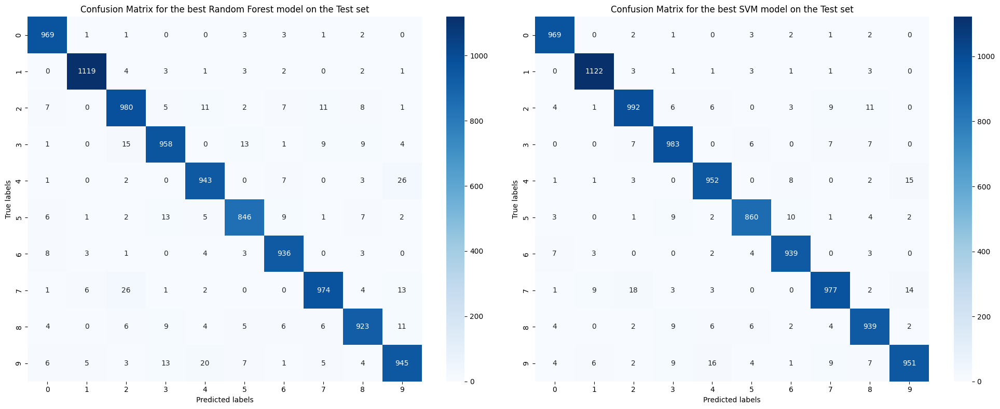

In [103]:
# TEST SET
# We compute the accuracy of the best Random Forest and SVM models on the test set
rf_test_accuracy = accuracy_score(y_test, best_rf_model.predict(X_test))
svm_test_accuracy = accuracy_score(y_test, best_svm_model.predict(X_test))

print("Test accuracy of the best Random Forest model: ", rf_test_accuracy)
print("Test accuracy of the best SVM model: ", svm_test_accuracy)

# We plot the confusion matrix for the best Random Forest model and the best SVM model
plt.figure(figsize=(20, 8))

plt.subplot(1, 2, 1)
sns.heatmap(confusion_matrix(y_test, best_rf_model.predict(X_test)), annot=True, fmt='d', cmap='Blues')
plt.title(f'Confusion Matrix for the best Random Forest model on the Test set')
plt.xlabel('Predicted labels')
plt.ylabel('True labels')

plt.subplot(1, 2, 2)
sns.heatmap(confusion_matrix(y_test, best_svm_model.predict(X_test)), annot=True, fmt='d', cmap='Blues')
plt.title(f'Confusion Matrix for the best SVM model on the Test set')
plt.xlabel('Predicted labels')
plt.ylabel('True labels')

plt.tight_layout()
plt.show()

Finally, we notice that the SVM model has a higher test accuracy of 96.8% compared to the Random Forest Classifier's 95.9%. This is consistent with the validation accuracy we obtained earlier. The SVM model is more robust to overfitting and generalizes better to unseen data. This is also reflected in the confusion matrices, where the SVM model has fewer misclassifications than the Random Forest Classifier for all numbers. Specifically, the SVM modle excels at predicting the number 3 (with 25 less mistakes), the number 5 (with 14 less mistakes), and the number 8 (with 16 less mistakes).

# Q2 YOLO Object Detection

## 2.1 Image Acquisition

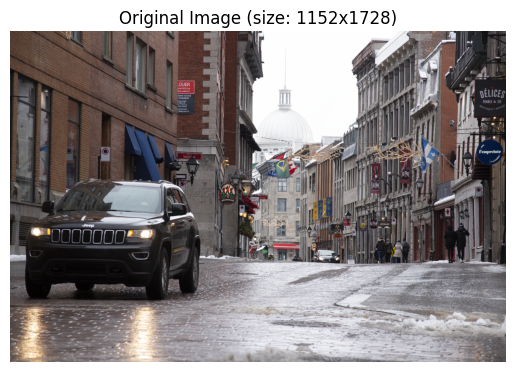

In [3]:
# We import the Montreal scene 
img = cv2.imread(path + "data/montreal.png")

# Resize the image to be 3 times smaller
img = cv2.resize(img, (int(img.shape[1]/3), int(img.shape[0]/3)))

# Plot the image
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.title(f'Original Image (size: {img.shape[0]}x{img.shape[1]})')
plt.axis('off')
plt.show()

## 2.2 Object Detection

### 2.2.1 + 2.2.2

Using cache found in /Users/enzobenoit-jeannin/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 2024-11-1 Python-3.12.6 torch-2.5.1 CPU

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
Adding AutoShape... 
/Users/enzobenoit-jeannin/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


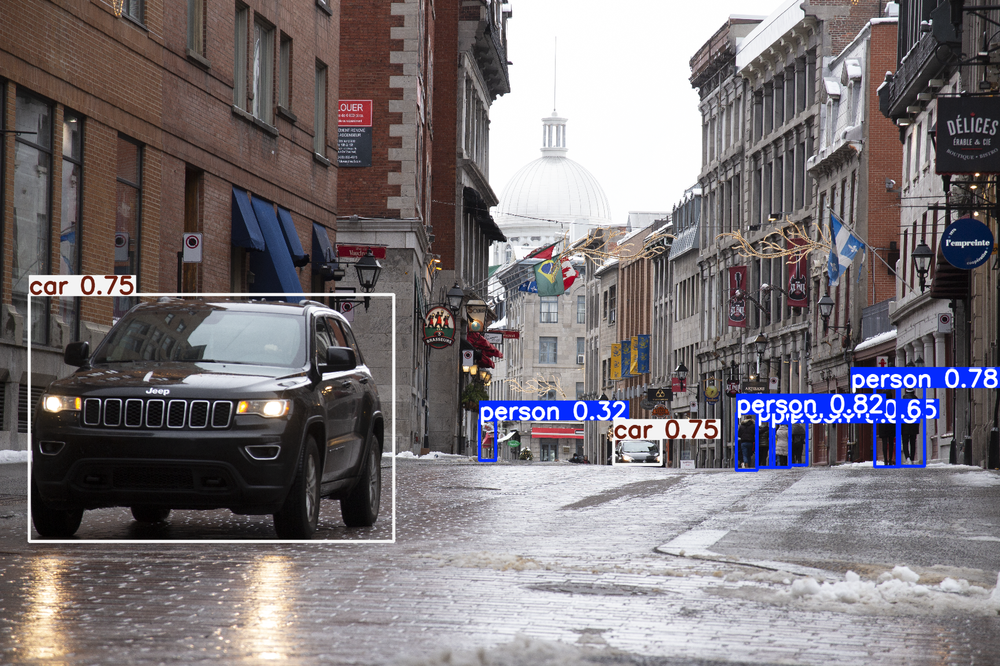

In [4]:
# We follow the instructions here: https://docs.ultralytics.com/yolov5/tutorials/pytorch_hub_model_loading/
# We use the pre-trained YOLOv5 model to detect objects in the Montreal scene image
# We installed the requirements: pip install -r https://raw.githubusercontent.com/ultralytics/yolov5/master/requirements.txt
# Device (mps)
device = 'mps'

# Set seed

# Model
model = torch.hub.load("ultralytics/yolov5", "yolov5s", pretrained=True).to(device)

# Inference
# Convert to RGB before inference
results = model(cv2.cvtColor(img, cv2.COLOR_BGR2RGB), size=640)

# Show results, which already contains the bounding boxes with the label of each object and the confidence score
# This also already uses non-maximum suppression to remove overlapping boxes
results.show()

The algorithm effectively outlined the detected objects with bounding boxes and corresponding labels as well as confidence levels. It also implemented non-max suppression, ensuring that no bounding boxes overlapped for the same object. The model accurately recognized both the prominent car in the foreground and a smaller car in the background, despite the latter being partially obscured by the road. Additionally, the model successfully detected people walking in the background making one misclassification by labelling a store deventure as a person.

### 2.2.3

Using cache found in /Users/enzobenoit-jeannin/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 2024-11-1 Python-3.12.6 torch-2.5.1 CPU

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
Adding AutoShape... 
/Users/enzobenoit-jeannin/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


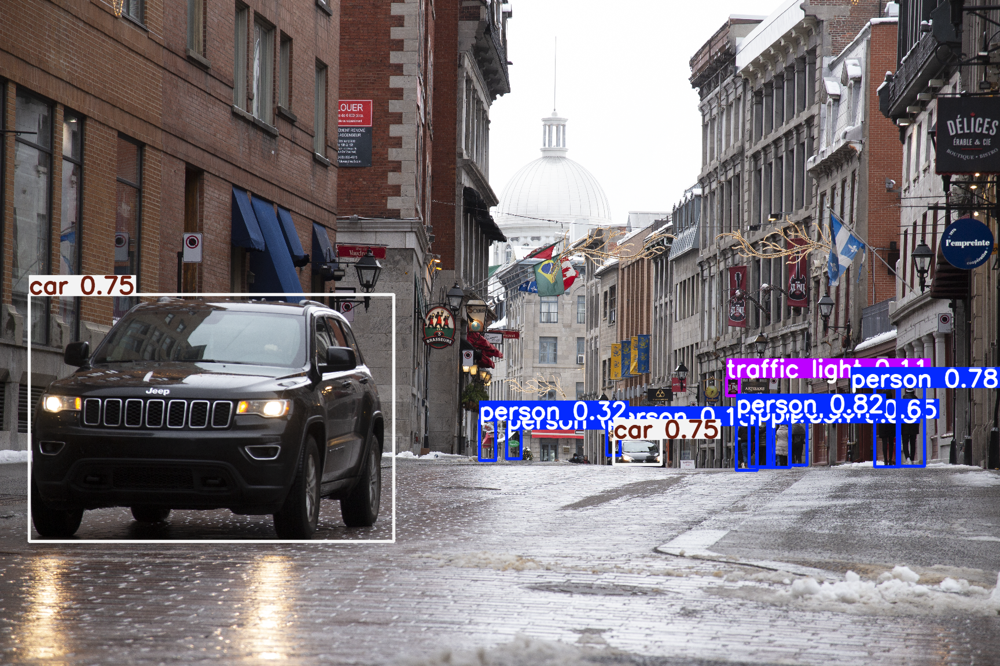

Using cache found in /Users/enzobenoit-jeannin/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 2024-11-1 Python-3.12.6 torch-2.5.1 CPU

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
Adding AutoShape... 
/Users/enzobenoit-jeannin/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


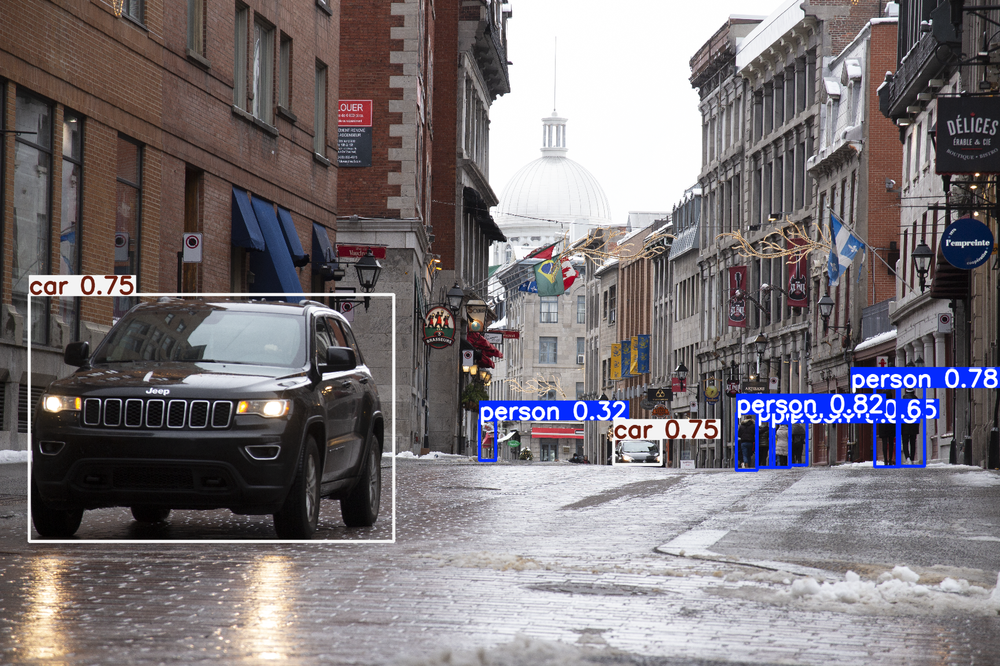

Using cache found in /Users/enzobenoit-jeannin/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 2024-11-1 Python-3.12.6 torch-2.5.1 CPU

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
Adding AutoShape... 
/Users/enzobenoit-jeannin/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


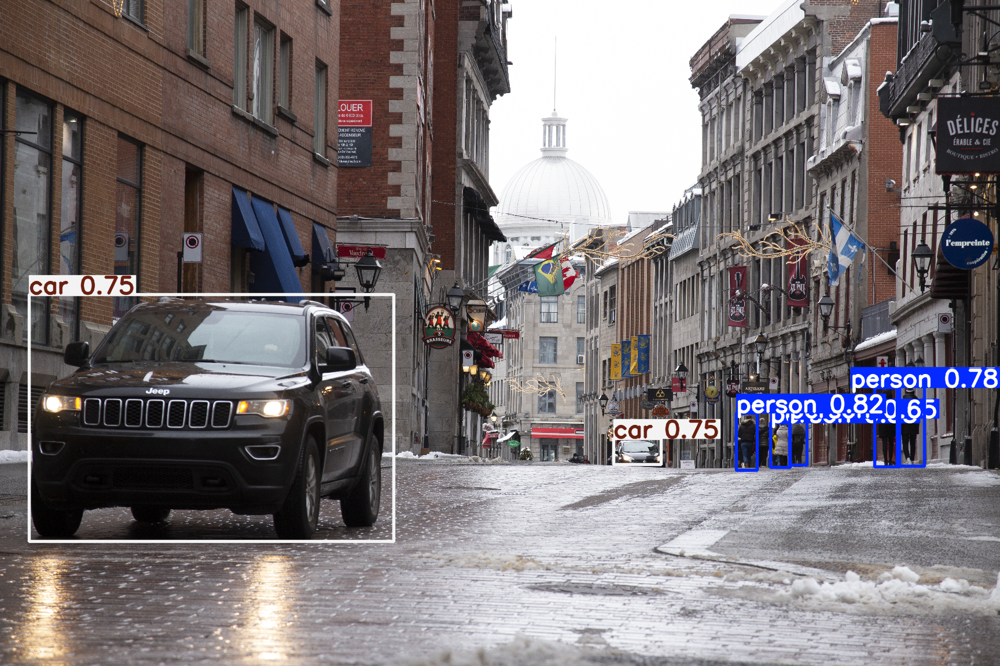

Using cache found in /Users/enzobenoit-jeannin/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 2024-11-1 Python-3.12.6 torch-2.5.1 CPU

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
Adding AutoShape... 
/Users/enzobenoit-jeannin/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


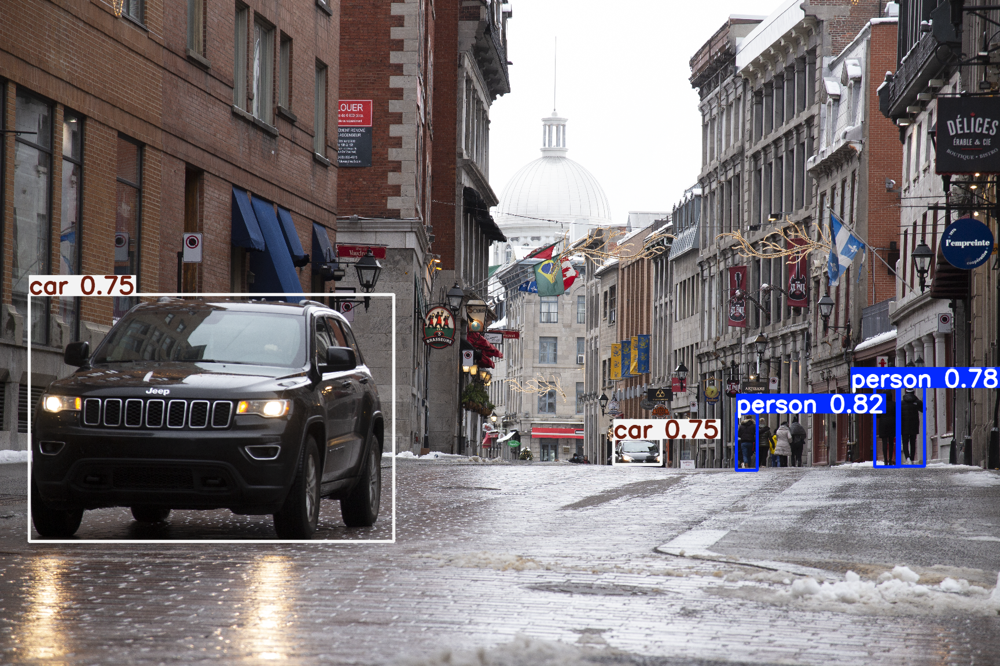

Using cache found in /Users/enzobenoit-jeannin/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 2024-11-1 Python-3.12.6 torch-2.5.1 CPU

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
Adding AutoShape... 
/Users/enzobenoit-jeannin/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


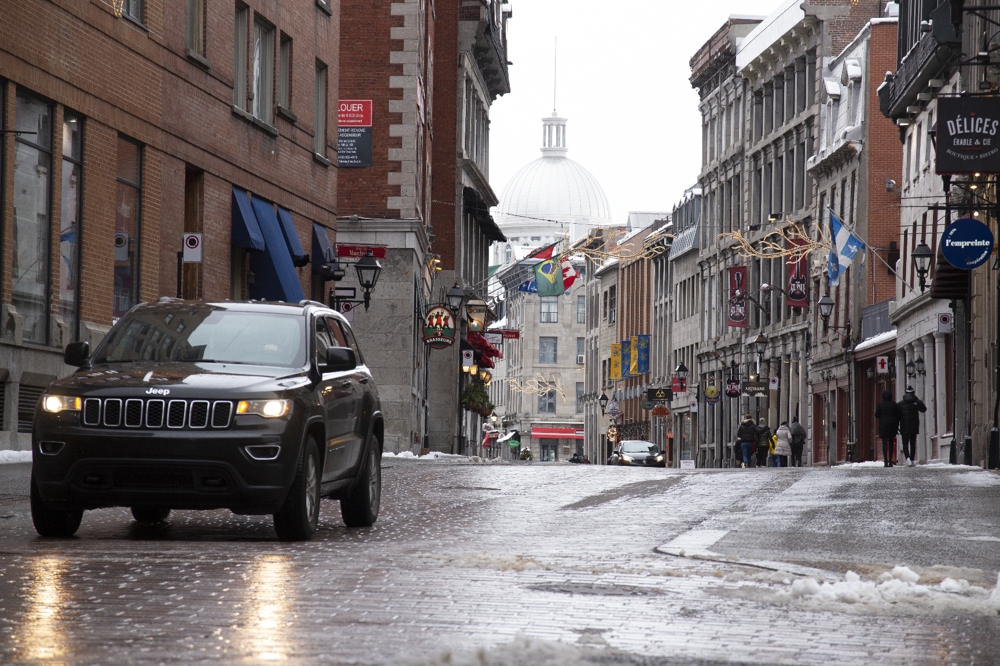

In [5]:
# We now experiment with different threshold values for object detection confidence and analyze how this impacts the number of detected objects
object_confidence_thresholds = [0.1, 0.3, 0.5, 0.7, 0.9]

# We plot the image with the detected objects for each threshold
for threshold in object_confidence_thresholds:
    model = torch.hub.load("ultralytics/yolov5", "yolov5s", pretrained=True).to(device)
    model.conf = threshold
    results = model(cv2.cvtColor(img, cv2.COLOR_BGR2RGB), size=640)
    results.show()

When we set a very low confidence threshold, the model identifies many more objects but also makes more incorrect detections. For instance, in the first image where the confidence threshold is 0.1, the model mistakenly identifies a store sign as a 'traffic light' and other store signs as 'people'. Setting the threshold to 0.3 results in only one erroneous identification of a store sign as a person. Raising the threshold to 0.5 eliminates all misclassifications without forgetting any other object in the image. However, at 0.7, the model fails to detect several people walking in the background, and at 0.9, it does not detect any objects at all.